<a href="https://colab.research.google.com/github/jmestanza/time_stretching/blob/master/Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
%cd /content
from IPython.display import clear_output

#imports
#!pip install librosa
!pip install webrtcvad
import webrtcvad
!pip install --upgrade librosa
import librosa 
import scipy
import numpy as np
from IPython.display import Audio
import matplotlib.pyplot as plt
from math import ceil 
import matplotlib.patches as mpatches

#local modules
!wget https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/detect_pitch_fixed.py
!wget https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/modified_psola_op.py
!wget https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/vad.py
!wget https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/utils.py
#audios
!wget "https://raw.githubusercontent.com/vicaub/Pitch-Estimation-and-Voicing-Detection/master/data/fda_ue/rl047.wav"
!wget "https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/input/harry_potter_es.wav"
!wget "https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/input/hunger_games_en.wav"
!wget "https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/input/shh.wav"
!wget "https://raw.githubusercontent.com/jmestanza/time_stretching/master/code/input/ahh_without_silences_8k_norm.wav"


clear_output()

In [0]:
from modified_psola_op import modified_psola
from detect_pitch_fixed import get_fundamental_frequency
from vad import float2pcm, pcm2float, frame_generator, join_vad_frames, get_vad_frames
from vad import Frame
from scipy import signal
from utils import *

clear_output()

## Prueba con un audio basico

In [149]:
fs = 48000
audio = "/content/hunger_games_en.wav"
Audio(data=audio, rate=fs)

In [150]:
y, sr = librosa.load(audio, sr=48000)
pitches, magnitudes = librosa.core.piptrack(y=y, sr=sr, fmin=75, fmax=300)
def detect_pitch(y, sr, t):
  index = magnitudes[:, t].argmax()
  pitch = pitches[index, t]
  return pitch

for i in range(len(pitches)):
    all_pitches.append(detect_pitch(pitch_arr[i],48000,i))

print(all_pitches)

[282.56213, 114.69278, 124.032036, 126.094215, 136.4591, 142.91776, 144.93773, 280.03427, 281.86795, 284.28113, 139.34006, 145.91672, 282.56238, 276.28772, 247.58243, 134.16016, 262.04523, 259.53543, 130.81389, 121.26318, 165.96202, 162.69861, 162.5113, 174.00468, 180.59634, 189.2175, 275.48587, 174.02292, 274.66312, 256.50357, 239.56949, 156.9811, 135.54251, 195.16954, 163.07568, 146.92706, 140.8332, 197.78944, 167.71846, 281.9395, 217.01868, 124.85771, 141.22104, 134.97925, 127.608246, 181.01263, 96.209984, 235.1261, 256.98676, 241.77017, 225.87135, 232.78725, 217.91557, 264.39536, 232.09114, 227.91296, 233.50156, 243.69453, 252.8793, 114.1835, 119.936005, 243.59209, 170.77846, 182.18385, 239.91644, 254.94922, 269.38614, 140.29094, 140.48672, 133.98969, 123.2795, 83.4305, 228.19484, 114.090324, 240.6298, 240.77895, 273.3664, 147.33195, 255.96567, 253.62276, 231.17479, 158.15344, 143.9609, 115.32599, 259.13443, 168.36136, 158.76471, 246.7883, 242.86325, 167.7147, 115.71719, 120.399345

In [151]:
fs = 8000
audio = "/content/ahh_without_silences_8k_norm.wav"
Audio(data=audio, rate=fs)

In [0]:
def get_f0s(audio, fs):
    pitches, magnitudes = librosa.core.piptrack(y=audio, sr=fs, fmin=75, fmax=500)
    def detect_pitch(y, sr, t):
        index = magnitudes[:, t].argmax()
        pitch = pitches[index, t]
        return pitch

    print(len(pitches))
    # parece haber siempre 1025:
    indices = []
    for i in range(len(pitches)):
        idx = int(i*(len(pitches)/len(audio)))
        try:
            p = detect_pitch(pitch_arr[i],fs,i)
            if p != 0:
                all_pitches.append(int(fs/p))
                indices.append(idx)
        except:
            pass
        #     all_pitches.append(0)

    return indices, all_pitches

def process_error(e, K, L, fs,p_pk,p_s,speed,is_voiced,regions, show_demo_ = False):
    # p_pk = percent_peak
    # p_s = percent_pitch
    #--------------------------------------------------------------  
    # Esto de aca se puede editar #
    #------------------------------  

    get_p = "pitch_cte" # manera asignar ventanas
    m = "2" # modo de asignar los t_ 
    unv_samples = int(20e-3 * fs) #360
    window_type = "hanning" # ventana con la que hago la correlacion

    #-------------------------------------------

    f0_idx,f0 = get_fundamental_frequency(e,is_voiced, K, L, fs,w_type = window_type ,show_demo = True)
    #f0_idx, f0 = get_f0s(e,fs)
        
    if show_demo_:
        plot_histogram(f0)
        show_demo_ = False
    
    e_, pz, uz = modified_psola(e, f0_idx, f0,p_pk, p_s, speed,is_voiced,regions,get_p,m, unv_samples)
    return e_, f0_idx, f0 , pz, uz


def speed_up(audio_path, speed, sample_rate, K,L, error_with_noise= False, lpc_entero = True):
    
    # paper https://pdfs.semanticscholar.org/7e00/c103c0197a05f9d20511ef03fd8bb0ba81a5.pdf
    # M0 = K,  20 ms
    
    
    #--------------------------------------------------------------  
    # Esto de aca se puede editar #
    #------------------------------  
    percent_pitch = 1 # 0.5 o 0.6 anda bien con "pitch variable"  y "2"
    peak_percent = 0.16
    std_ = 1e-2
    duration = 10 # empiezo desde 0 y recorto el audio hasta duration segundos
    
    #-------------------------------------------------------------------

    audio_f, audio_i = get_float_and_int_audio(audio_path,fs, cut_audio = duration) # audio_i lo necesita el VAD
    if error_with_noise:
        audio_f = get_noise_for_lpc(audio_f, std=std_) # contamino el audio con ruido
    else:
        audio_noised = get_noise_for_lpc(audio_f, std=std_) 
    # Relacion de compromiso, picos grandes o error grande en gral , se ve en el error 

    print("periodicidad minima que se puede estimar",fs/K, "Hz")

    speech, not_speech, is_voiced, frame_len = vad_config(audio_i, fs)

    regions = separate_regions(is_voiced)

    if lpc_entero:
        regions_lpc =  [[0,regions[-1][1]]]
    else:
        regions_lpc = regions.copy()
    
    if error_with_noise:
        error, lpc_coeffs = lpc_filtering(regions_lpc, audio_f, audio_f, coef_number=12)
    else:
        error, lpc_coeffs = lpc_filtering(regions_lpc, audio_f, audio_noised, coef_number=12) 
        # en este no contamino con ruido, tan solo saco los coef lpc con el ruido


    process_output = process_error(error, K, L, fs,peak_percent,percent_pitch,speed,is_voiced,regions)
    psola_error, f0_idx, f0, pitch_zones, unvoiced_zones =  process_output

    voiced_filt = lpc_defiltering(regions_lpc,speed,lpc_coeffs,psola_error)

    is_voiced = np.array(is_voiced)
    is_voiced = is_voiced.astype(np.int16)

    return voiced_filt, psola_error, error, audio_f, is_voiced, pitch_zones, unvoiced_zones, f0, regions

periodicidad minima que se puede estimar 100.0 Hz


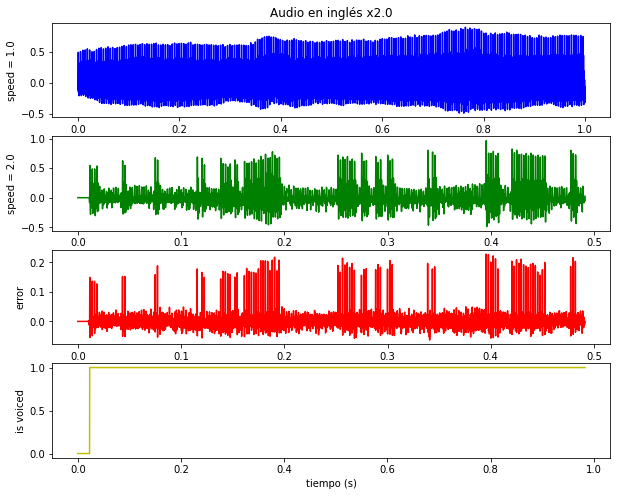

In [153]:
speed = 2.0
#K = int(20e-3 * fs) # esto no se mueve, 50Hz como minimo
#L = int(10e-3 * fs) # 
K = int(10e-3 * fs) # esto no se mueve, 50Hz como minimo
L = int(10e-3 * fs) # 

speed_up_output = speed_up(audio, speed, fs, K,L)
audio_final, psola_err, err, audio_original, is_voice, pz, uz, f0, regions = speed_up_output 

plot_four_signals(audio_original,audio_final,psola_err,is_voice,fs,speed, figsize_=(10,8))
#recordar que f0 es del error
Audio(data=audio_final, rate=fs)

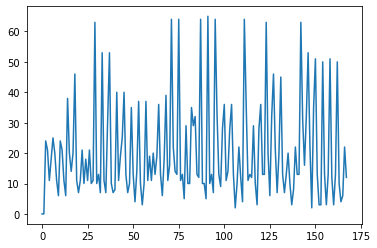

In [154]:
plt.plot(f0)

[[0, 159], [160, 6879]]
No se pudo plotear la suma


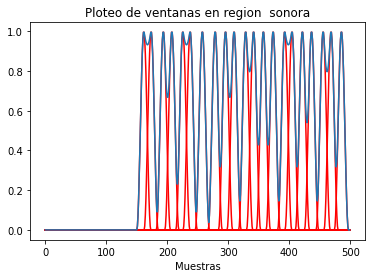

In [155]:
sub_regions = get_regions_in_new_time(regions,speed, mode= "floor")
print(sub_regions)

xl = "Muestras"
title = "Ploteo de ventanas en region no sonora"
draw_windows(uz,sub_regions, reg_num = 1, cnt_ventanas = 10, xlabel= xl,title = title, cant_muestras = 100)

xl = "Muestras"
title = "Ploteo de ventanas en region  sonora"

draw_windows(pz,sub_regions, reg_num = 0, cnt_ventanas = 100, xlabel= xl,title = title, cant_muestras= 500)

Text(0, 0.5, 'Pitch (Hz)')

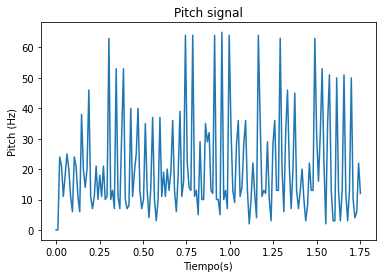

In [156]:
max_seg = len((audio_original))/fs
t = np.linspace(0,max_seg,len(f0))
f0_hat = [0 if el == 0 else fs/el for el in f0]
plt.plot(t,f0)
plt.title("Pitch signal")
plt.xlabel("Tiempo(s)")
plt.ylabel("Pitch (Hz)")

Text(0, 0.5, 'Pitch (Hz)')

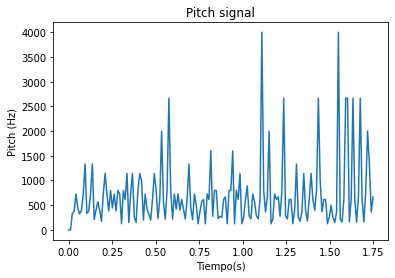

In [157]:
#plt.plot(f0)
#print(np.mean(f0))

max_seg = len((audio_original))/fs
t = np.linspace(0,max_seg,len(f0))
f0_hat = [0 if el == 0 else fs/el for el in f0]
plt.plot(t,f0_hat)
plt.title("Pitch signal")
plt.xlabel("Tiempo(s)")
plt.ylabel("Pitch (Hz)")

## Pruebas con otros audios

In [158]:
fs = 48000
audio = "/content/hunger_games_en.wav"
Audio(data=audio, rate=fs)

In [159]:
speed = 2.0
K = int(20e-3 * fs) # esto no se mueve, 50Hz como minimo
L = int(1e-3 * fs) # 

speed_up_output = speed_up(audio, speed, fs, K,L)
audio_final, psola_err, err, audio_original, is_voice, pz, uz, f0, regions = speed_up_output 

#plot_four_signals(audio_original,audio_final,psola_err,is_voice,fs,speed, figsize_=(10,8))
#recordar que f0 es del error
Audio(data=audio_final, rate=fs)

periodicidad minima que se puede estimar 50.0 Hz


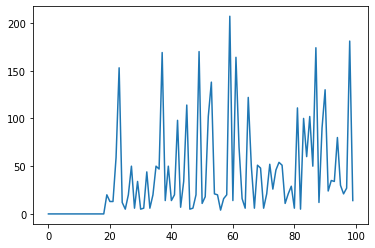

In [160]:
plt.plot(f0[:100])

In [161]:
!wget "https://raw.githubusercontent.com/sannawag/TD-PSOLA/master/female_scale.wav"
fs = 48000
audio = "/content/female_scale.wav"
Audio(data=audio, rate=fs)

--2020-05-31 16:38:03--  https://raw.githubusercontent.com/sannawag/TD-PSOLA/master/female_scale.wav
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3202330 (3.1M) [audio/wav]
Saving to: ‘female_scale.wav.2’

female_scale.wav.2  100%[===================>]   3.05M  15.3MB/s    in 0.2s    

2020-05-31 16:38:04 (15.3 MB/s) - ‘female_scale.wav.2’ saved [3202330/3202330]



periodicidad minima que se puede estimar 50.0 Hz


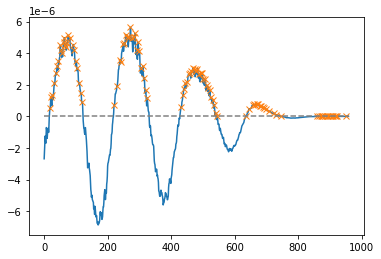

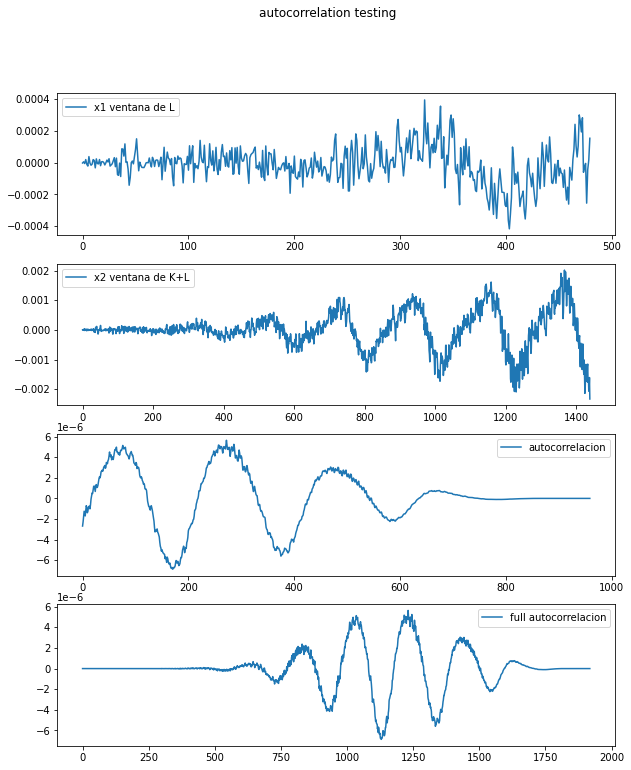

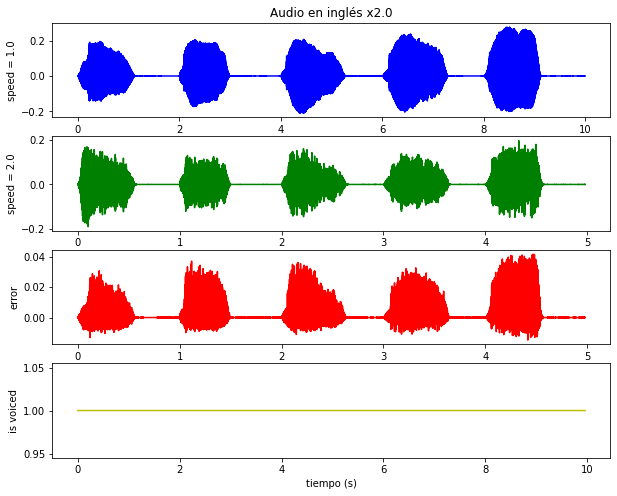

In [162]:
speed = 2.0
#K = int(20e-3 * fs) # esto no se mueve, 50Hz como minimo
#L = int(10e-3 * fs) # 
K = int(20e-3 * fs) # esto no se mueve, 50Hz como minimo
L = int(10e-3 * fs) # 

speed_up_output = speed_up(audio, speed, fs, K,L)
audio_final, psola_err, err, audio_original, is_voice, pz, uz, f0, regions = speed_up_output 

plot_four_signals(audio_original,audio_final,psola_err,is_voice,fs,speed, figsize_=(10,8))
#recordar que f0 es del error
Audio(data=audio_final, rate=fs)

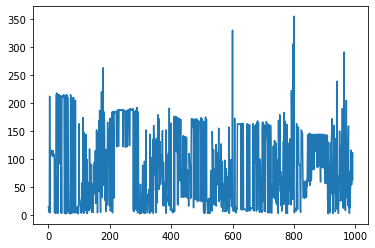

In [163]:
plt.plot(f0)

## Conclusiones hasta ahora

* Filtrado LPC provoca picos extraños en la señal 

* Filtrado LPC SHORT TIME no mejora respecto al que propusimos que era por separacion de regiones sonoras (LPC SHORT TIME toma ventanas)

Como se hizo LPC SHORT TIME:

Filtrado:

Agarre una ventana rectangular, la filtre con el error de prediccion y eso lo puse como error cada 20ms y con overlap de 50%.

Defiltrado del error de psola:

Ventanee con hanning overlap de 50%, la filtre con el inverso del filtro de error de prediccion.

*  Bug de volumen en PSOLA

## Conclusiones hasta ahora 2 
filtrado LPC provocaba picos extraños en la señal y además introducía un cambio en el volumen.

Para solucionar esto, añadimos un parámetro de regularización por medio de añadir ruido blanco al audio, regulando la varianza pudimos mejorar esta condición de LPC. 

## Conclusiones hasta ahora 3
habia un bug en regions

## Conclusiones hasta ahora 4
* Quedo arreglado el bug en regions (no las tiraba bien y por alguna razon daba algo que parecia estar bien)

* Quedo arreglado el bug de que iba subiendo el volumen (era que las ventanas no sonoras no sumaban 1)

* Se puede arreglar los picos en la señal error ajustando la varianza del ruido blanco gaussiano añadido al audio para filtrar LPC. OJO: Se obtienen los coeficientes con el ruido pero se filtra el original (o sea sin ruido).

# Aclaraciones sobre PSOLA
Hice un par de pruebas con psola. 

Actualmente en PSOLA hay dos formas de agarrar ventanas segun el pitch. 
## como son las ventanas para los distintos pitch
Originalmente estaba puesto para que busque los picos en la señal error y que a una cantidad constante de muestras a izquierda y derecha. Esto vi que no tiene buenos resultados dado que el pitch va cambiando. A esto llame **"pitch_cte" en modified_psola.**

Entonces lo tuve que cambiar para que se vaya adaptando al pitch la ventana. Es por esta razon que al ser ventanas de tamaño variable muy probablemente no sumen 1 (Antes no lo hacian a menos que sea pitch cte, lo cual es muy poco probable). A esta configuración la llame **"pitch_variable" en modified_psola.**



## Modo "1" y Modo "2"

Por otro lado **en modified_psola hay un modo "1" o "2"**, que tiene que ver con como se recalculan los tiempos y distancias cuando el tiempo es reducido. 
Ejemplo en speed = 1.5 = 3/2
Sabemos que en cualquier caso agarramos 2 ventanas cada 3.
Lo que varia en los metodos son los tiempos que asigno a las ventanas que tomo.

En "1":
* fijo primer t_= tpico1/speed 
* next_t = t_ + dist(pico1,pico2) // la distancia es en t original no en t_
* // como descarto la tercer ventana no computo dist(pico2,pico3)
* next_t = t_ + dist(pico1,pico2) + dist(pico3,pico4) 
* // dist(pico3,pico4) puede ser vista como lo que le falta al primer
* // conjunto de ventanas para llegar al segundo conjunto
* etc...

En "2":
* fijo primer t_ = tpico1/speed 
* next_t = t_ + dist(pico1,pico2) // la distancia es en t original no en t_
* // como descarto la tercer ventana no computo dist(pico2,pico3)
* fijo "siguiente"  t_ = tpico4/speed // "resincronizo"
* next_t = t_  + dist(pico4,pico5)
* etc...





## "percent pitch"

Esta variable maneja cuanto porcentaje del pitch agarra la ventana. Es decir si
ponemos 0.1, por cada ventana que haya (sea de tamaño variable o no), va a actualizar las muestras tomadas tanto para la izquierda como a la derecha en un factor *0.1. 
Ejemplo: Si originalmente tomo 100 a la izquierda y 100 a la derecha, al pasar este parametro, voy a tomar 10 a la izquierda y 10 a la derecha. Este factor es para poder tener un manejo de las ventanas, para poder acercarme lo mas posible a la condicion OLA.


Lo que determinó qué método se va a utilizar es básicamente que metodo presentaba ventanas menos conflictivas en el sentido de cumplir la condicion OLA (aunque sabemos que muy probablemente no se pueda)


Frente a estas modalidades, hay fotos sobre las pruebas que hice en [code/imagenes_nuevas
](https://github.com/jmestanza/time_stretching/tree/master/code/dibujos%20y%20graficos/imagenes_nuevas)

Lo que mejores resultados presento fue:
En general modo "2" daba mejores resultados.
Uno en particular que es aceptable es:

**pitch_variable con pitch_percent = 0.5 y modo "2"**

# Otros parametros configurables

## Regularizacion
En la funcion speed_up


```
audio_noised = get_noise_for_lpc(audio_f, std=1e-3)
```
std hace el juego de parametro de regularizacion para el lpc por regiones que se realiza



##Como se buscan los picos de la señal error 
### peak_percent
... =  process_error(error, K, L, fs,**peak_percent**,percent_pitch,speed,is_voiced,regions)

En la funcion modified_psola existe un parametro peak_percent que lo que hace es basicamente agarra un histograma de los pitches que salieron en la region sonora y se queda con el de maxima probabilidad.
Cuando se va a buscar picos, es importante setear una distancia minima para no tener picos absurdos. Es por eso que se setea una distancia minima de:

```
min_dist = max_prob_pitch-max_prob_pitch*peak_percent
```
Y se la pasa a la funcion scipy.signal.find_peaks


## Tamaño de las ventanas a usar en la autocorrelacion short time modificada
* W1 es de tamaño L
* W2 es de tamaño K+L

la maxima periodicidad detectable (segun filminas) es fs/K
para mi podria ser fs/(K+L)  pero **ni idea**


# Tamaño de las ventanas en regiones no sonoras
modified_psola recibe como parametro unvoiced_samples lo cual equivale al tamaño a usar para alguno de los lados (por ejemplo derecha), por lo cual define una ventana de 2*unvoiced_samples+1

supongo que habria que poner algo relacionado a 20ms

# Cantidad de coeficientes LPC
Usamos 12, no lo cambiaria porque creo que no mejoraba cuando lo cambiaba (A chequear)